# Basic MNIST Model
For testing the **NodeAnalysis** python library

In [7]:
import tensorflow as tf
from tensorflow import keras
from keras.models import Sequential
from keras.layers.core import Dense, Dropout, Activation
from keras.utils import np_utils
from keras.datasets import mnist

import numpy as np

from sklearn.preprocessing import LabelEncoder

from nodeanalysis.GetWeights import GetWeights as GW
from nodeanalysis.GetWeights import print_node_params
from nodeanalysis.NodeAnalysis import NodeAnalysisCallback as NAC

from nodeanalysis.nodes.EmptyNode import EmptyNode
from nodeanalysis.nodes.SimpleNeuron import SimpleNeuron

## MNIST Dataset 
### Load Dataset

In [8]:
(X_train, y_train), (X_test, y_test) = mnist.load_data()

In [9]:
print(f'X_train.shape = {X_train.shape}')
print(f'y_train.shape = {y_train.shape}')
print(f'X_test.shape = {X_test.shape}')
print(f'y_test.shape = {y_test.shape}')

X_train.shape = (60000, 28, 28)
y_train.shape = (60000,)
X_test.shape = (10000, 28, 28)
y_test.shape = (10000,)


### Pre-Processing
#### Normalization

In [10]:
X_train = X_train / 255
X_test = X_test / 255

print(f'sample X_train: \n{X_train[0][:5][:5]}\n')
print(f'sample X_test: \n{X_test[0][:5][:5]}')

sample X_train: 
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0.]]

sample X_test: 
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0.]]


#### Label Encoding

In [11]:
encoder = LabelEncoder()
encoder.fit(y_train)

y_train_encoded = encoder.transform(y_train)
y_classes = encoder.classes_
y_n = len(y_classes)

print(f'sample y_train_encoded = {y_train_encoded[:5]}')
print(f'classes = {y_classes} n = {y_n}')

sample y_train_encoded = [5 0 4 1 9]
classes = [0 1 2 3 4 5 6 7 8 9] n = 10


## Model
### Create Model

In [12]:
model = tf.keras.models.Sequential([
  tf.keras.layers.Flatten(input_shape=(28, 28, 1)),
  tf.keras.layers.Dense(128,activation='relu'),
  tf.keras.layers.Dense(10, activation='softmax')
])
model.compile(
    loss='sparse_categorical_crossentropy',
    optimizer=tf.keras.optimizers.Adam(0.001),
    metrics=['accuracy'],
)

model.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten (Flatten)            (None, 784)               0         
_________________________________________________________________
dense_8 (Dense)              (None, 128)               100480    
_________________________________________________________________
dense_9 (Dense)              (None, 10)                1290      
Total params: 101,770
Trainable params: 101,770
Non-trainable params: 0
_________________________________________________________________


### Train Model 

#### NodeAnalysis Callback

In [13]:
gw = NAC()

#### Train Model

In [14]:
history = model.fit(X_train, y_train,
        batch_size=128,
         epochs=20,
         validation_data=(X_test,y_test),
         callbacks=[gw])

Epoch 1/20
469/469 [==============================] - 2s 4ms/step - loss: 0.3633 - accuracy: 0.9003 - val_loss: 0.1985 - val_accuracy: 0.9420
Epoch 2/20
469/469 [==============================] - 2s 3ms/step - loss: 0.1685 - accuracy: 0.9522 - val_loss: 0.1356 - val_accuracy: 0.9592
Epoch 3/20
469/469 [==============================] - 2s 3ms/step - loss: 0.1189 - accuracy: 0.9655 - val_loss: 0.1091 - val_accuracy: 0.9670
Epoch 4/20
469/469 [==============================] - 2s 4ms/step - loss: 0.0913 - accuracy: 0.9736 - val_loss: 0.0970 - val_accuracy: 0.9708
Epoch 5/20
469/469 [==============================] - 1s 3ms/step - loss: 0.0734 - accuracy: 0.9790 - val_loss: 0.0849 - val_accuracy: 0.9747
Epoch 6/20
469/469 [==============================] - 1s 3ms/step - loss: 0.0606 - accuracy: 0.9823 - val_loss: 0.0790 - val_accuracy: 0.9738
Epoch 7/20
469/469 [==============================] - 1s 3ms/step - loss: 0.0501 - accuracy: 0.9851 - val_loss: 0.0768 - val_accuracy: 0.9760
Epoch 

#### Test NodeAnalysis

In [9]:
node = SimpleNeuron()
node.get(gw,-1,[1,1])
node.report()

NODE [name=Node dense_1 : [1, 1] epoch=-1]
	 layer_index=-1
	 node_index=[1, 1]

	 model=<tensorflow.python.keras.engine.sequential.Sequential object at 0x0000021AE01E9F70>
	 layer=<tensorflow.python.keras.layers.core.Dense object at 0x0000021AE01E9C10>

	 layer_in=<tensorflow.python.keras.layers.core.Dense object at 0x0000021AE01E98B0>
	 layer_out=<tensorflow.python.keras.layers.core.Flatten object at 0x0000021AE01CD400>

	 activation=<function softmax at 0x0000021ACD115790>
	 weight=-0.2820923924446106
	 bias=-0.04918287694454193
	 epochs=20


In [10]:
h = node.history(node.epochs, SimpleNeuron)

In [11]:
from nodeanalysis.visualization import SimpleNeuronVis as V

In [14]:
layer = V.getNodesFromLayer(gw, -1, SimpleNeuron)

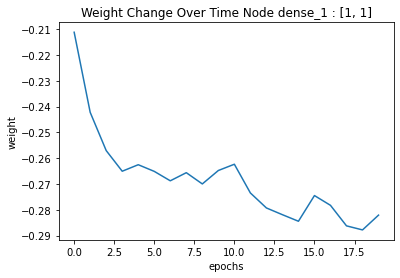

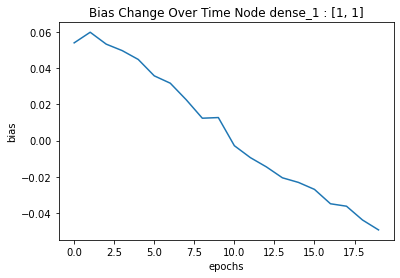

In [13]:
V.showWeights(h[0].history(h[0].epochs, SimpleNeuron))
V.showBias(h[0].history(h[0].epochs, SimpleNeuron))

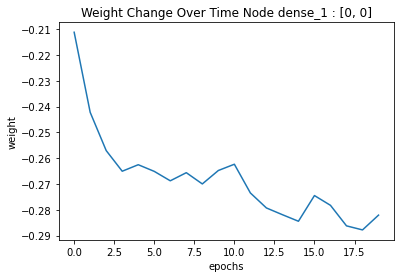

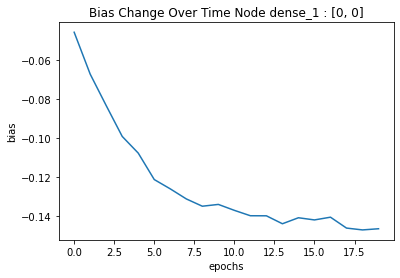

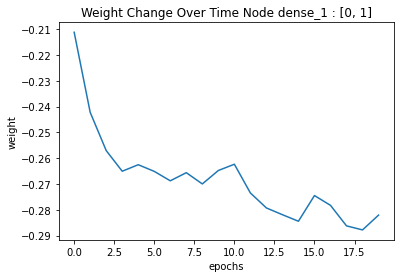

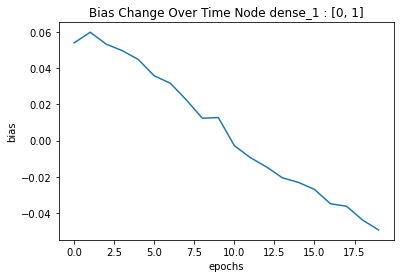

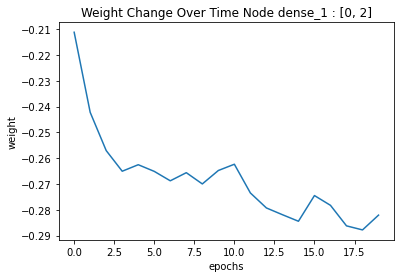

...

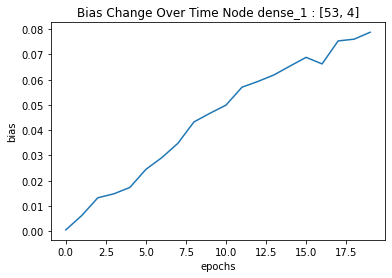

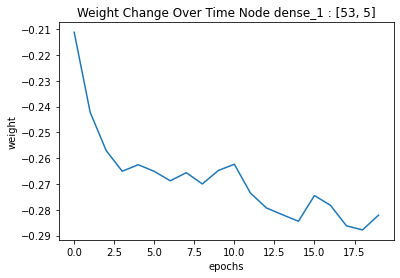

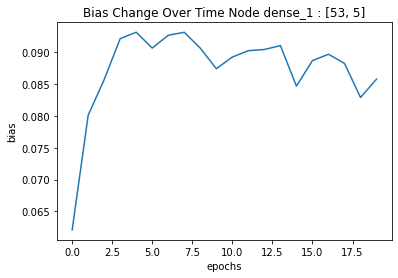

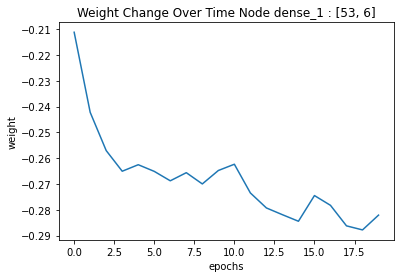

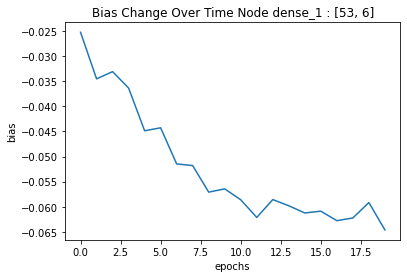

In [ ]:
for node in layer:
    V.showWeights(node.history(node.epochs, SimpleNeuron))
    V.showBias(node.history(node.epochs, SimpleNeuron))